<center> <font size="7"> Documentation : TP trajectoire circulaire </font> </center>
    
___
    Pierre BAGNARA
    pierre.bagnara47@gmail.com
    11 Juillet 2022
___
    
<center> Ce Notebook est associé au projet Python "TP_trajectoire_circulaire", développé avec le logiciel PyCharm. <br> 
    Il contient des cellules de code Python 3 et de Markdown directement exécutables (par le raccourci-clavier shift+Entrée une fois la cellule sélectionnée). </center> 

In [2]:
# --- Réinitialise les fonctions, variables et classes Python internes au document --- #
%reset -f

# ---- Import des librairies Python utiles pour ce Notebook ---- #
from IPython.display import Image, Video

___

# Pré-requis
___

## Généralités

Avant toute utilisation du programme, plusieurs conditions et remarques sont à prendre en compte.
- Le projet a été développé en Python 3.6.9 à l'aide du logiciel PyCharm Community Edition sous Ubuntu 18.04 Bionic LTS. Les versions plus récentes de Python et d'Ubuntu devraient normalement prendre en charge le projet, mais il est conseillé d'utiliser la même configuration que celle citée précédemment.
- Un répertoire en ligne a été créé sur GitHub pour garder une trace de l'évolution du projet et pour pouvoir l'installer sur n'importe quel PC équipé d'une connexion à Internet. Il est conseillé de mettre à jour régulièrement ce répertoire (ou une copie) pour sauvegarder les modifications apportées aux programmes.
- Après avoir installé le projet sur un PC à partir de GitHub, il est nécessaire de sélectionner l'interpréteur du projet pour pouvoir exécuter les programmes.
- Les librairies Python citées dans le fichier requirements.txt doivent être installées, si possible dans leurs versions les plus récentes. __Note : Lors de l'ouverture du fichier requirements.txt et si le PC est connecté à Internet, PyCharm affiche une pop-up et propose d'installer un module qui interprète directement le fichier et installe automatiquement les librairies et leurs dépendences.__

## Règles de sécurité
___

### De manière générale
La mise en oeuvre d'un ou plusieurs drones comporte des risques, et je conseille vivement à quiconque serait à proximité des drone de respecter les règles de sécurité basiques proposées ci-dessous pour minimiser son exposition au danger :
- Veiller à ce qu'aucun drone ne soit sous tension en dehors de son volume de vol prévu (exception faite lors de la connexion au drone par un cable USB);
- Veiller à ce qu'aucune personne ne soit dans l'arène de vol lorsque la LED avant-gauche du drone est allumée (cela signifie que le drone est connecté par radio, et qu'il peut donc décoller à tout moment).

### Batteries
Les batteries Lithium Polymère utilisées sur les drones sont le principal facteur de risque, notamment en raison de leur tendance à s'enflammer spontanément lorsqu'elles ne sont pas utilisées correctement. Ces batteries sont en effet sensibles à la perforation, au courant de charge et de décharge, à la température et à la tension de la cellule. <br> 
Pour limiter les prises de risque, les règles suivantes sont à respecter :
- Veiller à ce que la conservation longue durée des batteries se fasse dans de bonnes conditions (sacs imifugés, à l'abri des sources de chaleur et de la lumière du soleil, niveau de charge des batteries entre 23% et 30%.
- Veiller au bon état des batteries utilisées sur les drones, ne pas utiliser de batterie gonflée ni endommagée (la perforation de l'enveloppe provoque un incendie violent).
- Veiller à ne pas vider complètement une batterie pendant un vol (l'idéal est de ne jamais descendre en dessous de 20% de charge, soit une tension de 3.7V au repos). __Attention : une batterie déchargée à moins de 3.0V au repos est définitivement hors d'usage, ne surtout pas essayer de la recharger !__
- Toujours utiliser un chargeur spécifique aux batteries LiPo pour les recharger, et ne pas charger les batteries sans surveillance (risque d'incendie si la tension dépasse 4.2V).

___

## Système de Motion Capture

Le système de Motion Capture (MoCap) utilisé lors du développement du projet est composé de 8 caméras Qualisys Miqus reliées à un PC dédié uniquement au traitement des données des caméras avec le logiciel Qualisys Track Manager 2020.2. Ce système couvre un volume de vol d'environ 4m x 4m x 1.50m. <br>
Sur le logiciel QTM il est conseillé de créer un projet dédié à ce programme pour garder en mémoire les réglages requis. Ces réglages sont expliqués par la suite :
- Dans la fenêtre ```Tools > Project Options``` :
    * Dans l'onglet ```Input devices > Camera System```, la fréquence de capture des marqueurs est fixée à 100Hz, mais pour des raisons de vitesse de calcul, les données sont envoyées en temps réel à une fréquence réduite à 50Hz. __Note : l'exécution du programme est rythmée par la cadence de réception des données provenant de QTM. Un moyen efficace d'alléger la charge de calcul du PC qui gère le vol des drones est donc de réduire la fréquence d'émission des données par QTM. En revanche, il est déconseillé de la régler sur une valeur inférieure à 20Hz.__
    * Dans l'onglet ```Input devices > Camera System > Cameras``` : Les caméras sont toutes réglées avec le même temps d'exposition et de flash en mode marker : $ 400 \mu s$, et avec le même seuil de détection des marqueurs : 30%. En revanche, dans ```Exposure delay```, l'option "advanced" est sélectionnée, ce qui permet de régler un délai avant le flash de chacune des caméras. Afin qu'elles flashent l'une après l'autre pour ne pas se perturber entre elles, chacune des 8 caméras a son propre délai parmi la liste suivante : $ [0 \mu s, 1000 \mu s, 2000 \mu s, 3000 \mu s, 4000 \mu s, 5000 \mu s, 6000 \mu s, 7000 \mu s]$.
    * Dans l'onglet ```Input devices > Calibration``` : Le repère est défini tel que l'axe pointant vers le haut est l'axe Z positif, et l'axe suivant le bras le plus long de l'équerre est l'axe X positif.
    * Dans l'onglet ```Processing``` : Dans la partie 'Real time actions', seules les cases ```Process every frame``` et ```Track each frame in 3D``` sont cochées. __Attention à ne pas cocher la case ```Calculate 6DOF``` !__
    * Dans l'onglet ```Processing > Euler Angles``` : La définition des angles d'Euler est fixée sur "Custom", de type "Local", selon les paramètres du tableau suivant. 
    | Numéro de rotation | Axe de rotation | Sens positif | Nom | Intervalle |
    | --- | --- | --- | --- | --- |
    | 1 | Z | Clockwise (CW) | Yaw | [-180° ; 180°] |
    | 2 | Y | Counterclockwise (CCW) | Pitch | [-90° ; 90°] |
    | 3 | X | Clockwise (CW) | Roll | [-180° ; 180°] |
- La calibration doit être particulièrement soignée : les drones sont de petite taille et n'ont qu'un seul marqueur pour être repérés, le tracking doit donc être précis et fiable sur l'entièreté du volume de vol. A titre d'indication, lors du développement de ce projet, la durée de calibration a été réglée sur 20min et les résultats obtenus sont affichés ci-dessous.

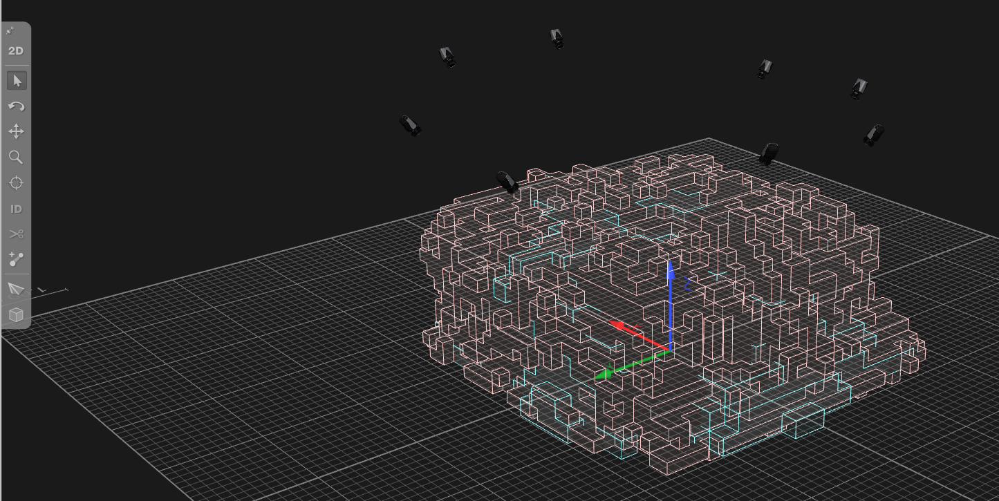

In [8]:
Image(filename='Images/Calibration_QTM.png')

## Drones Crazyflie
___

Une application open-source développée en Python par Bitcraze, le constructeur des drones Crazyflie, permet de configurer les drones et de les tester individuellement avant de les faire voler en essaim de manière automatique. Cette application a pour nom ```cfclient``` et peut être installée depuis le site officiel de Bitcraze. <br>
__Note : le cfclient propose un onglet "Qualisys" avec des fonctions directement intégrées pour faire voler un Crazyflie asservi en position grâce à QTM. Cependant, cet onglet est souvent défectueux dans les versions les plus récentes du cfclient. Je conseille donc de ne pas passer trop de temps à essayer d'utiliser cette fonctionnalité__ _(Avant de développer ce projet, j'ai déjà essayé de modifier le code source du cfclient pour rendre cet onglet opérationnel, cela a fonctionné pendant quelques semaines, puis la mise à jour vers une nouvelle version de l'application a rendu l'onglet défectueux à nouveau)._

### Description du drone
___

Quelques caractéristiques importantes sont à noter sur le drone Crazyflie :

#### Avant / Arrière et sens de rotation des hélices



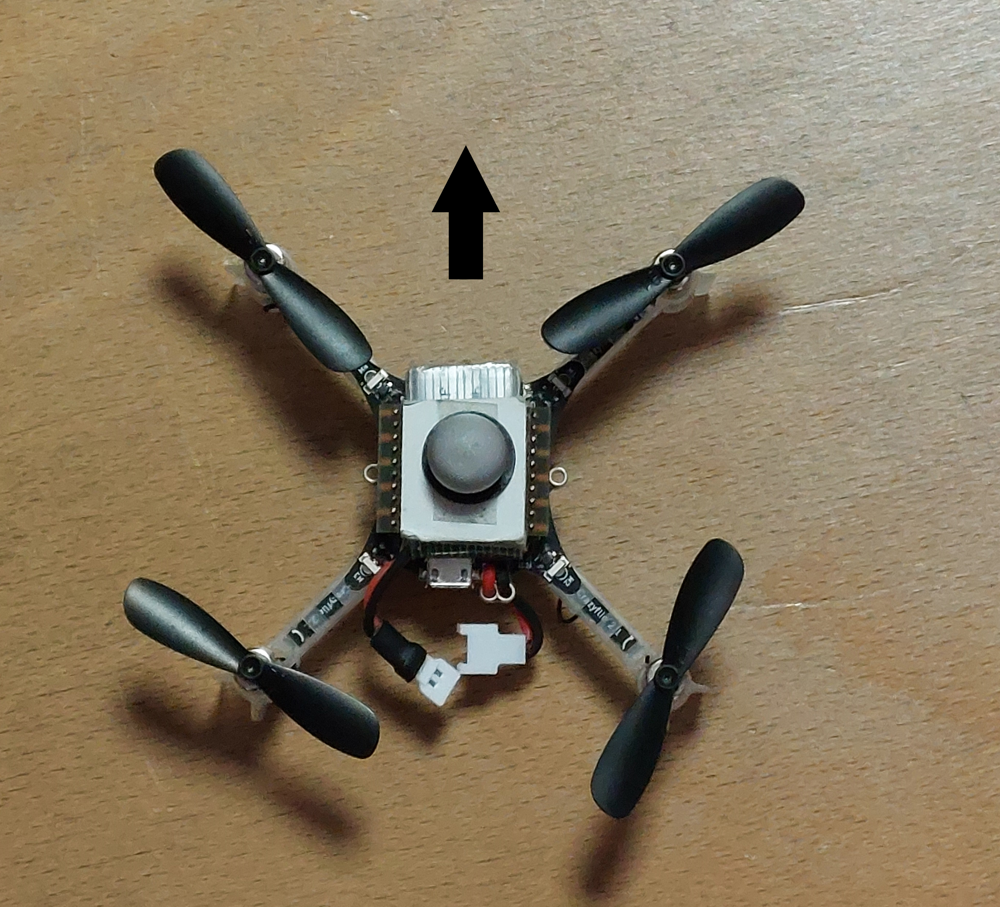

In [23]:
Image(filename='Images/Crazyflie_top.png')

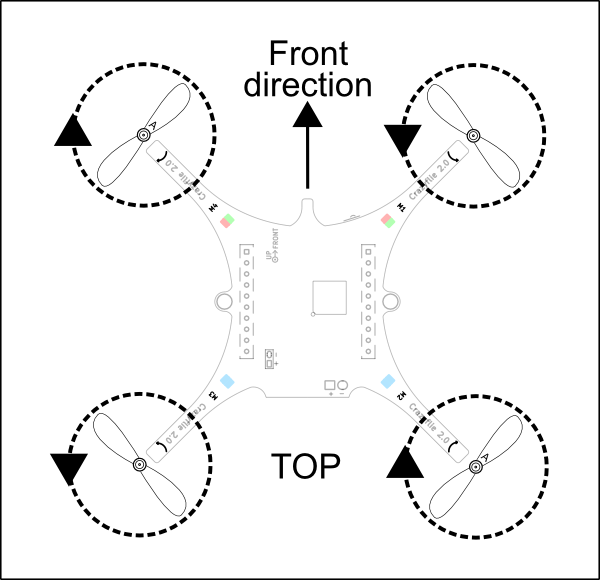

In [22]:
Image(filename='Images/cf_schema.png')

#### LED

- La LED avant gauche donne une indication sur la qualité du signal radio. Lorsque le drone n'est pas connecté, la LED est éteinte, elle s'allume en vert lorsque la qualité du signal est bonne, et devient progressivement orange lorsque la qualité du signal se dégrade.
- La LED avant droit (de couleur rouge) du Crazyflie permet d'obtenir des informations sur son état : le drone est dans son état nominal lorsque cette LED clignote rapidement (~ 2 fois par seconde). Si cette LED clignote lentement (~ 1 fois toutes les 2 secondes), l'estimation d'attitude n'est pas correctement calibrée et il est nécessaire de poser le drone sur une surface plane avant toute tentative de décollage. Si la LED reste allumée, le drone n'a pas suffisamment d'énergie pour commencer un vol, et il est nécessaire de changer sa batterie.
- Les deux LED arrières (de couleur bleue) sont allumées dès lors que le drone est sous tension, le firmware du drone ne permet malheureusement pas d'en modifier facilement le comportement.

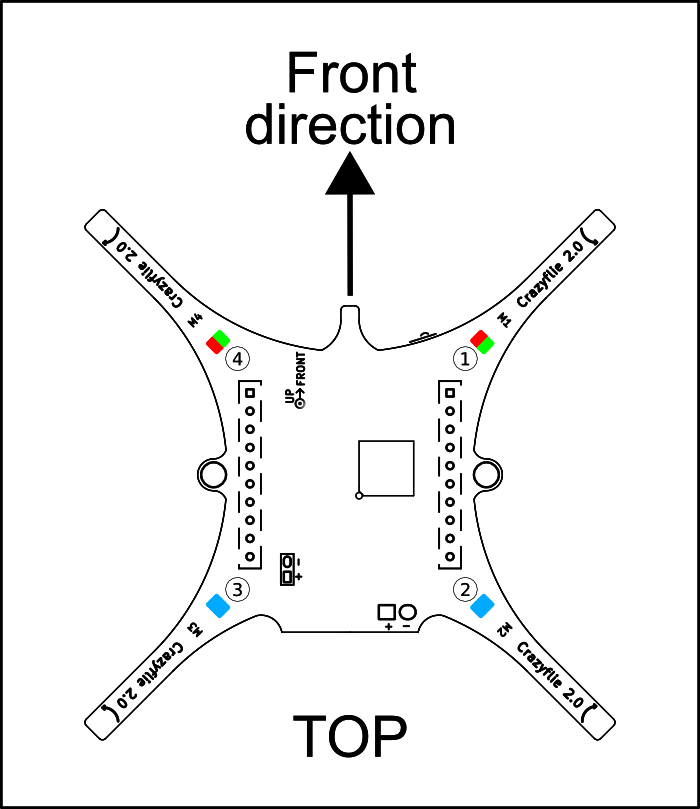

In [11]:
Image(filename='Images/cf_front_on_off.png')

#### Bouton ON / OFF

Pour allumer ou éteindre le drone Crazyflie, un bouton poussoir est situé à côté de l'antenne radio, à l'avant du drone.

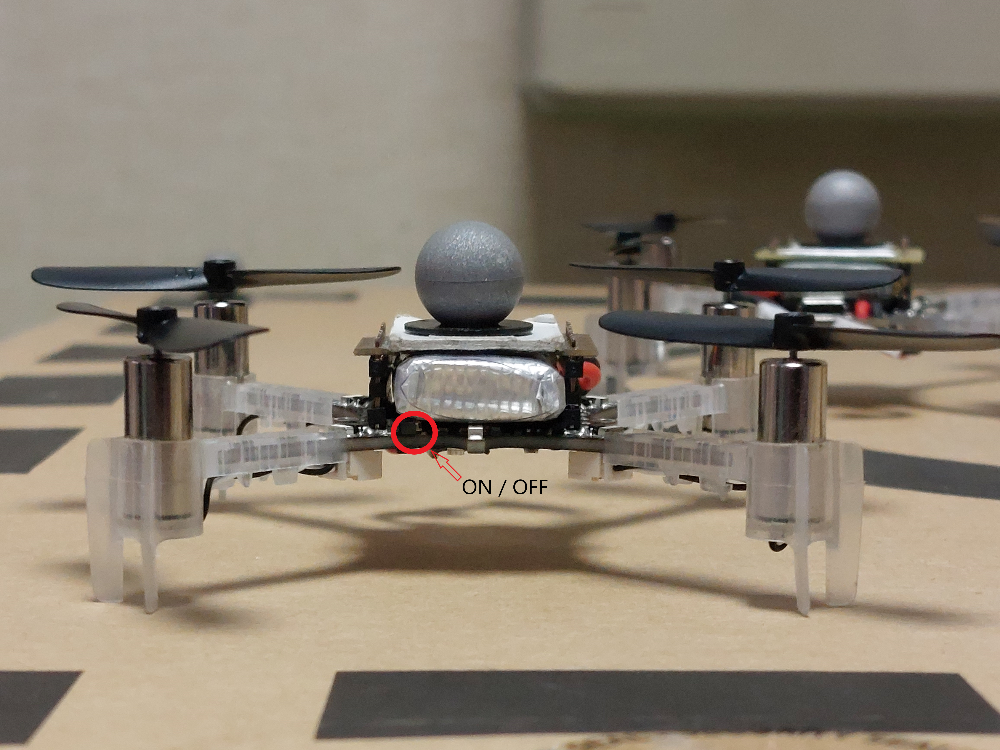

In [12]:
Image(filename='Images/Crazyflie_front.png')

___

### Première connexion

A partir du cfclient, la toute première connexion à un drone Crazyflie s'effectue par un cable usb en branchant le Crazyflie au PC utilisé. Ensuite, le bouton "scan" permet d'identifier le drone et de déverouiller le bouton Connect pour l'interface "usb://0". Il est dès lors possible de se connecter au Crazyflie. <br>
Une fois la connexion établie, on observe un retour d'informations concernant le drone en temps réel, comme par exemple son attitude dans l'onglet ```Flight Control```. <br>
Dans la fenêtre ```Connect > Configure 2.X```, plusieurs paramètres doivent être renseignés pour pouvoir se connecter au drone par radio. Il est préférable d'attributer un numéro de "radio channel" unique pour chaque drone, de régler la "Radio bandwidth" sur la plus grande valeur proposée, et d'attribuer une adresse unique pour chaque drone en suivant le format standard suivant : "0xE7E7E7E7XX" (en remplaçant XX par le numéro du drone en question). <br>
__Note : il est vivement conseillé de noter ce numéro sur une étiquette et de la coller sur le drone correspondant pour l'identifier visuellement.__

### Connection par radio et check-list pré-vol

Avant chaque vol, je conseille vivement d'appliquer la procédure détaillée par la suite, qui permet de vérifier le bon état du drone tout au long des étapes de préparation du vol. <br>
- La première étape est un contrôle visuel du drone. On vérifie : 
    * l'état de surface des hélices (pas de dégâts sur les bords d'attaque ni de fissure).
    * le bon positionnement des hélices (certaines tournent dans le sens horaire, d'autres tournent dans le sens anti-horaire), et leur bon maintien sur l'axe moteur.
    * les axes des moteurs (pas tordus, propres : attention aux cheveux et fibres textiles qui peuvent s'enrouler autour des axes et s'accumuler à leur base)
    * le bon maintien des moteurs dans leurs emplacements.
    * le bon maintien des supports de moteur (pas de jeu, pas de dégâts au niveau des pattes).
    * le bon état de la batterie (pas gonflée, pas de choc apparent) et son bon maintien dans son emplacement.
    * le bon état des cosses permettant de brancher la batterie (pas pincées, isolation des fils électriques en bon état) <br><br>
    
- Le vol manuel permis par le cfclient utilise une manette de XBox 360 pour contrôler le drone. On vérifie donc le bon fonctionnement de la manette et la bonne lecture des entrées par le cfclient avant de se connecter au drone. __Note : le branchement d'une manette n'est pas forcément détecté par le cfclient lorsqu'il est déjà ouvert, il peut être nécessaire de redémarrer le cfclient.__ Dans l'onglet ```Flight control```, la partie "Gamepad input" montre en temps réel les commandes lues par le cfclient.

- Le drone peut ensuite être déposé dans son volume de vol et mis sous tension. Il est alors possible de s'y connecter par radio depuis le cfclient en sélectionant son adresse, puis en appuyant sur le bouton Scan (plusieurs appuis peuvent être nécessaires, en particulier si le drone a été mis sous tension récemment). Une fois le drone détecté avec l'interface "radio://0/XX/YY/E7E7E7E7ZZ" (XX = Radio channel, YY = Radio bandwidth, ZZ = Numéro du drone), le bouton Connect est déverouillé et la connexion au drone par radio peut s'établir. __Note : dès lors que le drone est connecté, il est contrôlé par la manette $\rightarrow$ attention aux faux mouvements !__

- Quelques contrôles supplémentaires de l'état du drone sont désormais disponibles :
    * Le niveau de batterie.
    * La qualité de la liaison par radio.
    * L'équilibrage des rotors : dans l'onglet ```Console``` (qui peut être affiché depuis ```View > Tabs```), un bouton "Propeller test" est disponible. Ce test permet de faire tourner chaque hélice l'une après l'autre, et de récupérer l'écart type des signaux des accéléromètres. On obtient alors une représentation de l'intensité des vibrations causées par la rotation de chaque hélice. Des vibrations trop importantes peuvent altérer le maintien en position des hélices, ce qui entraîne un risque de décrochement et de projection de ces dernières pendant le vol. Il est donc conseillé de surveiller régulièrement ces résultats, notamment après un crash. <br> Les valeurs limites d'écart type tolérées par le cfclient sont de 2.50, en pratique il est conseillé d'éviter de faire voler un drone si l'un des écarts type dépasse 1.30. <br> Pour atténuer les vibrations causées par les hélices, une méthode simple consiste à les faire tourner par rapport à leurs axes moteurs respectifs, et de trouver itérativement l'écart type minimum qui correspond à la situation où les balourds des moteurs sont compensés au mieux par les balourds des hélices.

### Essai en vol

Une fois la check-list pré-vol terminée et le drone connecté par radio, un vol d'essai permet d'assurer la validation de la dynamique du vol du drone. Le drone est par défaut paramétré en mode attitude, il n'est donc pas asservi en position ni en vitesse. Les commandes sont difficiles à maîtriser sans expérience, c'est pourquoi j'invite le télépilote à rester très humble sur ses objectifs de vol. <br>
Ici, le but n'est pas de trouver les limites du drone mais de s'assurer que son comportement est sain avant d'implémenter les asservissements.

### Check-list post-vol

Après avoir posé et déconnecté le drone, deux contrôles principaux permettent d'identifier d'éventuels problèmes sur le drone immédiatement après le vol : le contrôle de la température des moteurs, et le contrôle de la température de la batterie. <br>
__Attention : Ne surtout pas mettre en charge une batterie qui vient d'être utilisée sans lui laisser le temps de refroidir.__

___
___

# Objectifs

Le but de ce projet Python est de servir de support à l'apprentissage pour des étudiants de l'Ecole de l'Air et de l'Espace. Il comporte une base de programme développée au préalable, mais volontairement laissée incomplète. Les étudiants ont alors pour mission de remplir les fonctions manquantes pour faire fonctionner le programme, et contrôler un drone Crazyflie en suivant un plan de vol ou des objectifs définis. <br>
La finalité de ce projet consiste à déterminer les signaux de consigne et les lois de commande en roulis et en tangage d'un drone Crazyflie pour lui faire décrire 3 trajectoires de référence :
- Une trajectoire circulaire à cap constant ;
- Une trajectoire circulaire avec un cap variable tel que l'axe x du drone (dans son repère propre) soit colinéaire avec son vecteur vitesse ;
- Une trajectoire de type Point Of Interest (POI, voir vidéo ci-dessous) où le drone suit un robot terrestre mobile en décrivant une trajectoire circulaire autour de ce dernier, tout en maintenant un cap tel que le drone soit face au robot à tout instant (scénario de surveillance si le drone était muni d'une caméra embarquée à l'avant).

Ce Notebook permet de présenter le fonctionnement du programme en dressant son architecture globale, puis de présenter son utilisation en listant les principaux paramètres et réglages.

In [7]:
Video('Images/POI.mp4')

# Architecture du projet
___

Ce projet est composé de 10 scripts Python interconnectés. <br> 
Le programme principal est contenu dans le script "main.py", et chaque autre script peut être vu comme un module en charge d'une tâche ou d'une séquence de tâches spécifique, sur laquelle le programme principal s'appuie pour fonctionner correctement. Pour la plupart, ces modules peuvent être testés individuellement afin de vérifier leur bon fonctionnement : à la fin du script, cliquez sur la flèche verte associée à la ligne ci-dessous pour lancer un programme de test du module correspondant.
```python
if __name__ == '__main__':
```
Le comportement attendu du programme de test est décrit en commentaires.

Le schéma présenté dans la cellule suivante permet d'illustrer les liens entre les différents modules, et les informations échangées via ces liens.

## Description des modes de fonctionnement
___

Trois modes de fonctionnement sont disponibles pour ce programme. Les fonctions appelées par ces modes et les interactions entre les modules Python sont présentées sur les schémas associés à chaque mode.

### Mode principal

Le mode principal permet de faire voler le drone réel. Il est exécuté à partir de la ligne 
```python
if __name__ == '__main__':
```
du script "main.py'.

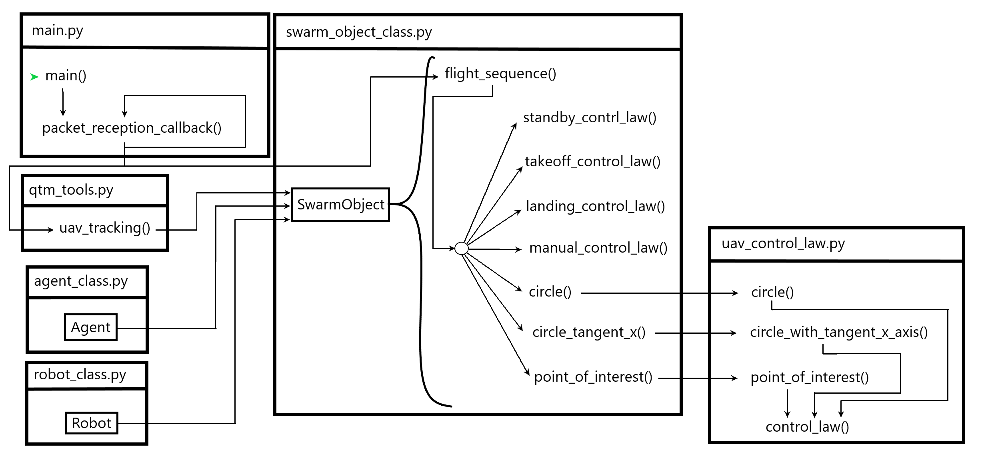

In [4]:
Image(filename='Images/main_program_architecture.png')

### Mode de simulation

Le mode de simulation permet d'évaluer les lois de commande sur un modèle virtuel du drone. Il est utile pour repérer des défauts ou erreurs dans les lois de commande avant de les implémenter sur le drone réel.

Ce mode peut être exécuté à partir de la ligne 
```python
if __name__ == '__main__':
```
du script "simulation.py".

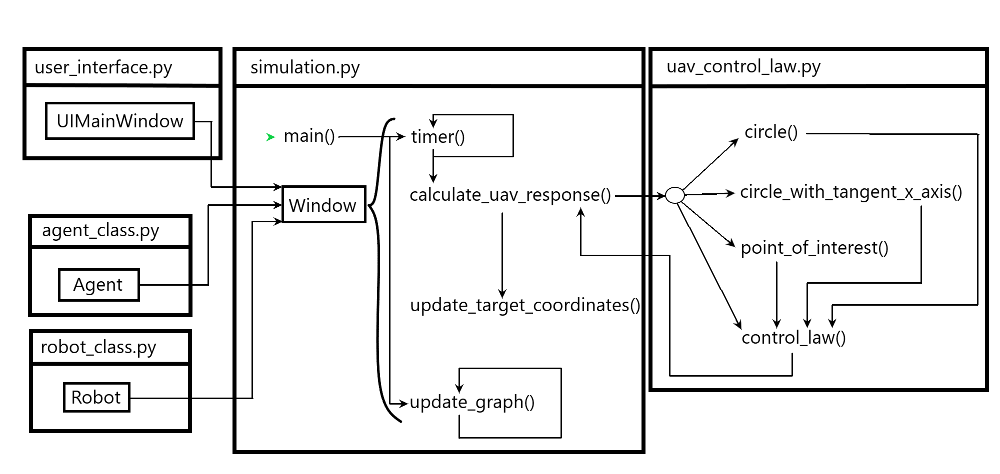

In [5]:
Image(filename='Images/simulation_architecture.png')

### Visualisation des données de vol

Une fois que le vol est terminé, un outil de visualisation permet de restituer les données du vol (en réel ou en simulation) sous forme de graphiques. On trouve par exemple la trajectoire du drone en 3D, les chronogrammes des commandes et de l'attitude mesurée, etc...

Cet outil prend la forme d'un Notebook interactif IPython : ```flight_logs_dashboard.ipynb```, à ouvrir depuis Jupyterlab. Tout le code Python nécessaire à la lecture du fichier de logs et à l'affichage des graphiques est déjà implémenté, et il suffit de lancer l'exécution de toutes les cellules pour générer le rendu.

___

## Description des modules Python
___

### agent_class.py : élément de base

Le script "agent_class.py" contient uniquement la définition de la classe ```Agent```. <br>
Une instance de la classe ```Agent``` est attribuée à chaque drone Crazyflie. Cette instance a pour rôle de représenter le drone qui lui est associé, mais aussi de regrouper toutes les informations qui le concernent directement, comme par exemple son adresse radio et ses paramètres de vol. C'est à partir de cette instance de classe que l'on peut gérer la communication par radio avec le drone, en lui envoyant sa position réelle mesurée, mais aussi des consignes d'attitude, de vitesse, de position, ou en récupérant les logs des variables internes à son firmware.

### robot_class.py : élément de base

Le script "robot_class.py" contient uniquement la définition de la classe ```Robot```. <br>
Une instance de la classe ```Robot``` est attribuée à chaque robot terrestre présent dans l'arène. Sachant que les robots terrestres ne sont pas pilotés par le programme Python, cette instance de classe ne permet pas de communiquer avec le robot qu'elle représente. En revanche, elle contient des informations utiles comme sa localisation en 3D dans le repère de l'arène.

### qtm_tools.py : fonctions utiles à la localisation des marqueurs dans l'arène de vol

Le script "qtm_tools.py" assure les tâches liées au traitement des données de QTM. Il contient uniquement des fonctions (pas de classes) qui sont appelées par le programme principal lors de son exécution. On peut par exemple trouver la fonction ```connect_to_qtm(ip)``` qui permet d'établir la connexion au service Qualisys Track Manager à partir de son adresse IP. On trouve également des fonctions de tracking qui permettent l'identification d'un marqueur et son suivi d'une frame à l'autre.

### swarm_object_class.py : gestion de groupes de drones

L'architecture de ce programme est dérivée d'un projet plus généraliste qui a pour but de contrôler plusieurs drones en même temps. La classe ```SwarmObject``` permet dans ce cas de gérer les variables et fonctions qui concernent le groupe de drones auquel elle est associée. Dans le projet actuel, l'instance de classe ```SwarmObject``` utilisée comprend une seule instance de classe ```Agent``` qui représente l'unique drone utilisé pour le TP, mais également une instance de classe ```Robot``` associée au robot terrestre en mouvement dans l'arène de vol. <br>
Dans le cadre du programme de TP, le rôle principal de la classe ```SwarmObject``` est de gérer les différentes étapes du vol d'un Crazyflie (comme le ferait une machine à états), et d'aiguiller le programme vers la loi de commande qui correspond au besoin à chaque instant (on préfère utiliser le firmware du drone pour gérer le décollage, l'attérrissage et le vol stationnaire, mais basculer sur la loi de commande écrite par les étudiants pour gérer les trajectoires de type circulaire). <br>
Cette classe permet également de veiller à la bonne initialisation du programme et de la connexion au drone et à QTM avant de déverouiller l'accès au contrôle du drone.

### joystick_class.py : contrôle manuel

Le script "joystick_class.py" contient la définition de la classe ```Joystick```, qui permet de lire les entrées du Joystick ou de la manette branchée au PC par usb, et de commander les actions à réaliser par chaque drone (changement d'état, contrôle manuel, etc...).

### joystick_map.py : affectation des commandes

___

Le script "joystick_map.py" sert uniquement à gérer les affectations des commandes : les commandes sont réparties sur les touches de la manette ou du joystick connecté, et les associations bouton-commande sont définies pour chaque modèle de joystick ou de manette à disposition. <br>
Par défaut, les affectations sont présentées dans les parties suivantes :

#### Joystick

- Bouton 1 (Gachette) $\rightarrow$ Arrêt d'urgence
- Bouton 2 (Pouce) $\rightarrow$ Décollage / Atterrissage
- Bouton 3 $\rightarrow$ Maintien en vol stationnaire
- Bouton 4 $\rightarrow$ Contrôle manuel de la position du drone
- Bouton 5 $\rightarrow$ Cap + 22.5° (sens anti-horaire en vue de dessus)
- Bouton 6 $\rightarrow$ Cap - 22.5° (sens horaire en vue de dessus)
- Bouton 7 $\rightarrow$ Point Of Interest
- Bouton 8 $\rightarrow$ [Non affecté]
- Bouton 9 $\rightarrow$ Trajectoire circulaire avec suivi de cap
- Bouton 10 $\rightarrow$ [Non affecté]
- Bouton 11 $\rightarrow$ Trajectoire circulaire à cap constant
- Bouton 12 $\rightarrow$ [Non affecté]

#### Manette de XBox 360

- Bouton Start $\rightarrow$ Arrêt d'urgence
- Bouton Select $\rightarrow$ [Non affecté]
- Bouton Mode $\rightarrow$ [Non affecté]
- Bouton A $\rightarrow$ Décollage / Atterrissage
- Bouton B $\rightarrow$ Point Of Interest
- Bouton X $\rightarrow$ Trajectoire circulaire à cap constant
- Bouton Y $\rightarrow$ Trajectoire circulaire avec suivi de cap
- Bouton Rx $\rightarrow$ Contrôle manuel de la position du drone
- Bouton Lx $\rightarrow$ Maintien en vol stationnaire

___

### uav_control_law.py : loi de commande et signaux de consigne

Ce script contient les fonctions qui permettent de générer les signaux de consigne en position et en cap pour faire décrire au drone des trajectoires de type circulaire (cercle à cap constant, cercle à cap variable, POI). Il contient également la fonction qui gère la loi de commande du drone : elle permet de calculer la consigne d'attitude à envoyer au drone en fonction de sa consigne de position. <br>
Ces fonctions sont le principal objet de travail des étudiants sur ce TP, elles sont partiellement effacées lorsque le programme leur est remis, et leur mission est de compléter les parties manquantes avec leur propre loi de commande et leur propre méthode de génération des signaux de consigne.

### main.py : programme principal

Le script 'main.py' héberge le programme principal qui permet de faire voler le drone Crazyflie.
Ce programme suit la procédure de connexion à QTM, puis au drone, et lance le streaming des données provenant de QTM. Une fois cette initialisation complétée, la réception d'un paquet de données provenant de QTM entraine l'exécution d'une routine ```paquet_reception_callback(packet)```, qui fait appel aux différents modules présentés pour gérer le vol automatique du drone. <br>
Ce script contient également les principaux paramètres de vol. <br>
Avec "uav_control_law.py", il fait partie des seuls scripts qui requièrent des modifications pour faire voler un Crazyflie. Tous les autres scripts n'ont pas lieu d'être édités par les étudiants eux-mêmes.

### sim_user_interface.py

Le script "sim_user_interface.py" a été généré automatiquement par l'application QTDesigner. Il regroupe la définition et le paramétrage de l'interface graphique utilisée par le programme en mode simulation.

### simulation.py : simulateur de drone

Le script "simulation.py" héberge un simulateur du comportement du drone sur le plan horizontal. Le modèle virtuel du drone est basé sur un double intégrateur en x et y. Le comportement en hauteur n'est en revanche pas modélisé.

___
___

# Mode d'emploi
___

On expose ici les informations les plus importantes pour paramétrer correctement le programme avant de lancer son exécution.

## Paramètres de vol
___

Le bouton de lancement du programme (flèche verte) est situé dans le script ```main.py```, à gauche de la ligne 142 :
```python
if __name__ == '__main__':
```
Les lignes qui suivent permettent de déclarer les variables globales nécessaires au bon fonctionnement du programme, puis d'exécuter la fonction ```main()```. <br>
C'est dans cette fonction que les principaux paramètres de vol sont réglés.

### main() | Flight parameters

On commence par entrer l'adresse IP du serveur QTM : ```qtm_ip_address```, sous forme de chaîne de caractères, puis on crée une liste ```agents```, qui contient la représentation du drone Crazyflie sous la forme d'une instance de la classe ```Agent```. La déclaration d'un Agent nécessite deux arguments : son nom sous la forme d'une chaîne de caractères (arbitraire), et son URI sous la forme 'radio://R/CC/BB/E7E7E7E7XX' (avec R : numéro du dongle radio, CC Radio Channel, BB : Radio bandwidth, XX : Numéro du drone). <br>
Ensuite, on règle les paramètres de vol du drone. Parmi ces paramètres, on trouve :
- La position initiale avant décollage (coordonnées [x, y, z] en m). __Attention : cette position sert à associer chaque drone à un marqueur dans l'arène. Je conseille à l'utilisateur de porter une grande attention sur la cohérence entre la position initiale déclarée et la position initiale réelle du drone. Des positions incohérentes peuvent aboutir à une mauvaise association drone-marqueur par le programme, ce qui résulte généralement en un drone qui part à pleine vitesse en direction du plafond.__
- La hauteur ciblée lors du décollage (en m).

__Attention : l'unique marqueur placé sur le drone ne permet pas de mesurer son orientation dans l'espace. On part donc du principe qu'avant le décollage, le drone est posé sur une surface horizontale et que le vecteur $\vec{x}$ du repère du drone est colinéaire au vecteur $\vec{x}$ du repère de l'arène de vol. Par conséquent, il est extrêmement important d'aligner correctement le drone face au mur Est de l'arène de vol avant le décollage.__

Puis, on déclare le robot terrestre sous la forme d'une instance de la classe ```swarm_object_class.Robot``` dans la liste ```robots``` (cette liste peut rester vide si aucun robot n'est présent dans l'arène), et on renseigne sa position initiale, tout comme pour le Crazyflie.


### main() | Swarm settings

Le dernier réglage à apporter dans la fonction ```main()``` est la déclaration de l'Agent qui répondra au contrôle manuel si l'utilisateur active le mode correspondant. On veille à ce que le nom qui figure dans la liste ```SWARM_MANAGER.manual_flight_agents_list``` soit bien identique au nom donné à l'Agent qui représente le Crazyflie. <br>
Dans le cas d'un mauvais paramétrage, le vol automatique du Crazyflie ne sera pas affecté, en revanche le mode de pilotage manuel sera verouillé.

___

## Paramètres avancés
___

Plusieurs paramètres plus spécifiques peuvent être réglés dans les fichiers agent_cass.py, swarm_object_class.py et joystick_map.py si besoin.

### Agent_class.py
___

#### Délimitation du volume de vol et des tolérances d'attitude

- Agent.max_roll (°) : détermine la tolérance d'angle de roulis maximum. Une mesure du roulis supérieure à cette valeur provoque l'arrêt d'urgence du drone.
- Agent.max_pitch (°) : détermine la tolérance d'angle de tangage maximum. Une mesure du tangage supérieure à cette valeur provoque l'arrêt d'urgence du drone.
- Agent.x_boundaries [x_min (m), x_max (m)] : délimite le volume de vol selon l'axe x. Si un drone est repréré en dehors de cet intervalle, l'arrêt d'urgence de ses moteurs sera déclenché.
- Agent.y_boundaries [y_min (m), y_max (m)] : délimite le volume de vol selon l'axe y. Si un drone est repréré en dehors de cet intervalle, l'arrêt d'urgence de ses moteurs sera déclenché.
- Agent.z_boundaries [z_min (m), z_max (m)] : délimite le volume de vol selon l'axe z. Si un drone est repréré en dehors de cet intervalle, l'arrêt d'urgence de ses moteurs sera déclenché.

#### Configuration du drone Crazyflie et logs

- Agent.stabilizer_estimator : permet de spécifier le type de stabilisateur utilisé pendant le vol (voir la documentation du Crazyflie).
- Agent.log_config : instance de classe cflib.crazyflie.log.LogConfig qui permet de récupérer les valeurs des variables internes au drone parmi une liste de logs accessibles.
___

### swarm_object_class.py

- SwarmObject.distance_to_waypoint_threshold (m) : rayon de la sphère de tolérance autour d'un objectif. Si le drone est à l'intérieur de cette sphère, on considère que l'objectif est atteint.

### joystick_map.py

Le fichier joystick_map.py contient le paramétrage des touches de la manette ou du joystick utilisé.
Toutes les touches peuvent être modifiées à la guise de l'utilisateur.

Le paramètre "mode" permet, sur la manette de XBox 360, d'intervertir les joysticks : le mode 1 affecte le contrôle du tangage et du roulis sur le joystick gauche, puis le contrôle de la hauteur et du lacet sur le joystick droit, alors que le mode 2 affecte le contrôle de la hauteur et du lacet sur le joystick gauche, puis le contrôle du tangage et du roulis sur le joystick droit.

___

## Déroulé nominal d'un vol

Après avoir lancé l'exécution du programme principal, plusieurs secondes d'attente sont nécessaires afin d'initialiser la connexion à QTM et au drone. La liste des marqueurs trouvés par QTM est présentée, puis les informations du joystick connecté sont affichées, des logs s'affichent en rouge dans la fenêtre de commande, et la fin de l'initialisation est matérialisée par la présentation d'un tableau récapitulatif des informations du drone (coordonnées, niveau de batterie, statut).

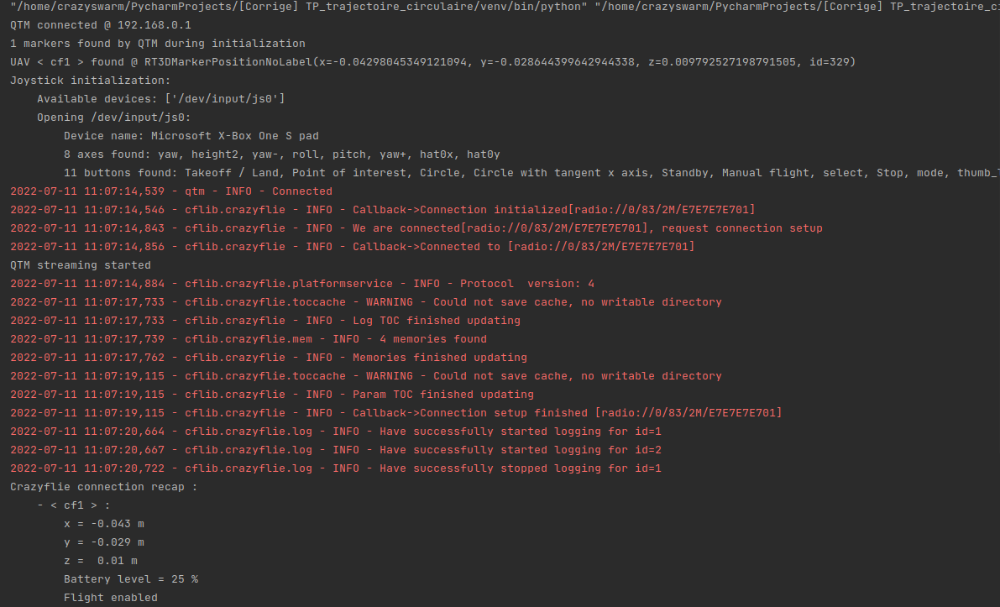

In [13]:
Image(filename='Images/Pre_flight_init.png')

Dès que ce tableau est visible dans la fenêtre de commande, il est possible de faire décoller le drone en appuyant sur la touche correspondante (voir affectations des touches par défaut). __Note : si le drone a le statut "Flight disabled", il ne répondra pas à la commande de décollage, la raison de sa désactivation est généralement expliquée par un avertissement antérieur au tableau, ou par une déconnexion du drone.__

Une fois que le drone a décollé et qu'il a rejoint sa position ciblée (x et y définis par sa position initiale, et z défini dans main()), il bascule en mode 'Standby', qui est un mode d'attente en vol stationnaire.

A partir de ce mode, l'utilisateur peut à tout moment appeler les fonctions qu'il désire en appuyant sur les boutons correspondants du joystick ou de la manette. <br>
__Note : le drone est verouiilé après un atterrissage. Pour le faire décoller à nouveau, il est nécessaire de redémarrer le programme.__

Après avoir terminé le vol, l'arrêt du programme requiert deux actions à réaliser dans l'ordre :
- Appuyer sur le bouton d'arrêt d'urgence du joystick ou de la manette $\rightarrow$ verrouille tous les drones et termine le thread qui gère les entrées utilisateur.
- Appuyer sur le bouton Echap du clavier $\rightarrow$ Déconnecte les drones, déconnecte QTM et termine le thread principal.

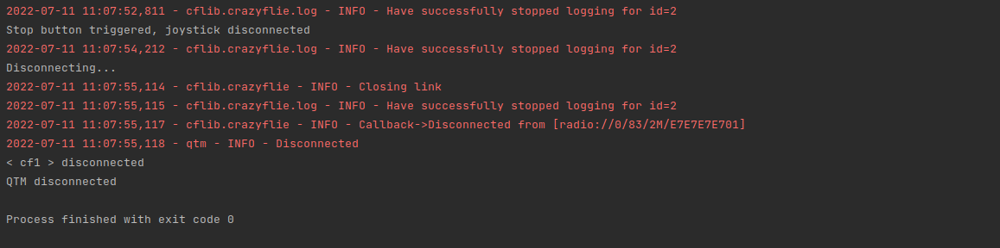

In [14]:
Image(filename='Images/Post_flight.png')

## Avertissements et erreurs
___

Cette section montre quelques erreurs ou avertissements qui peuvent être rencontrés lors de l'exécution du programme, et propose des explications sur les causes probables de ces phénomènes.

### Avant le décollage

| Avertissement | Description | Solutions proposées |
| --- | --- | --- |
| Error during QTM connection | La connexion à QTM a échoué | Vérifier que les données des caméras soient bien émises sur le réseau, et que l'adresse IP de QTM est la bonne dans les paramètres du programme |
| Too few detected markers than expected | Le nombre de marqueurs détectés par QTM ne correspond pas au nombre de marqueurs attendu (calculé en fonction du nombre de drones et de robots déclarés dans les paramètres du programme) | Vérifier la cohérence entre les paramètres déclarés dans le programme et la scène réelle dans l'arène de vol |
| Too many detected markers than expected | Le nombre de marqueurs détectés par QTM ne correspond pas au nombre de marqueurs attendu (calculé en fonction du nombre de drones et de robots déclarés dans les paramètres du programme) | Vérifier la cohérence entre les paramètres déclarés dans le programme et la scène réelle dans l'arène de vol, s'assurer qu'aucun marqueur parasite n'est détecté par les caméras (lumière du soleil, objet réflechissant dans l'arène, etc...) |
| Crazyflie not tracked | Aucun marqueur n'a été associé au drone (généralement affiché à la suite d'un autre avertissement antérieur) | Vérifier la cohérence entre les paramètres déclarés dans le programme et la scène réelle dans l'arène de vol. __Note : parfois cet avertissement est déclenché sans raison apparente lorsque QTM a été activé peu de temps avant le lancement du programme. Dans ce cas, vérifier la bonne communication avec QTM via le programme de test du module qtm_tools.py, et relancer le programme principal__ |
| Low battery level | Le niveau de batterie du drone n'est pas suffisant pour commencer un vol | Changer la batterie du drone en question |
| Abnormal attitude detected | Le filtre de Kalman du drone n'a pas pas pu converger à temps après son recalage avec les données des caméras | Relancer le programme. Si le problème persiste : redémarrer le drone |
| <span style="color:red"> FileNotFoundError: No such file or directory: '/dev/input/js0' </span> | Aucun joystick ou manette n'a été trouvé | Brancher une manette ou un joystick |


### Une fois que le drone est en vol

| Avertissement | Description | Solutions proposées |
| --- | --- | --- |
| Robot lost | Le marqueur associé au robot terrestre est sorti du champ de vision des caméras | S'assurer que le robot ne s'approche pas trop des limites du volume couvert par les caméras, et vérifier la qualité de la calibration des caméras |
| UAV lost | Le marqueur associé au drone est sorti du champ de vision des caméras | S'assurer que le drone ne s'approche pas trop des limites du volume couvert par les caméras, et vérifier la qualité de la calibration des caméras |
| UAV off camera for too long | Le marqueur associé au drone est sorti du champ de vision des caméras pendant un temps trop long, l'arrêt d'urgence est déclenché par sécurité | S'assurer que le drone ne s'approche pas trop des limites du volume couvert par les caméras, et vérifier la qualité de la calibration des caméras |
| Abnormal attitude detected | Le drone a dépassé ses limites de vol (sortie des limites en x, y et z et/ou sortie des limites en angles de roulis et tangage) |  S'assurer que le drone ne s'approche pas trop des limites du volume couvert par les caméras, et que les lois de commandes ne sont pas trop agressives |
| Callback execution interrupted by new QTM packet | La séquence de commandes qui permet de piloter le drone ne s'exécute pas correctement | Vérifier qu'il n'y ait pas d'erreur dans la loi de commande, et que les calculs ne soient pas trop gourmands en ressources machine |

___
___